In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider
import pandas as pd
import sunpy
import sunpy.map
from sunpy.coordinates import (get_earth, get_horizons_coord,
                                Helioprojective, propagate_with_solar_surface)
import sunkit_image
import sunkit_image.coalignment as coalignment
import astropy
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS
import astropy.units as u
import astropy.constants as const
import eispac

import cmcrameri.cm as cmcm
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.ticker import (AutoLocator, AutoMinorLocator, 
    FixedLocator, FixedFormatter, LogLocator, StrMethodFormatter)
from ipywidgets import interactive, widgets
from IPython.display import display, clear_output
from astropy.visualization import (AsinhStretch, LinearStretch,
        LogStretch, ImageNormalize)
import os
from sun_blinker import SunBlinker
from copy import deepcopy   


In [2]:
def plot_colorbar(im, ax, width="3%", height="100%",loc="lower left",fontsize=14,
                  bbox_to_anchor=(1.02, 0., 1, 1),orientation="vertical"):
    clb_ax = inset_axes(ax,width=width,height=height,loc=loc,
                bbox_to_anchor=bbox_to_anchor,
                 bbox_transform=ax.transAxes,
                 borderpad=0)
    clb = plt.colorbar(im,pad = 0.05,orientation=orientation,ax=ax,cax=clb_ax)
    clb_ax.yaxis.set_minor_locator(AutoMinorLocator(5))
    clb_ax.yaxis.get_offset_text().set_fontsize(fontsize)
    clb_ax.tick_params(labelsize=fontsize)
    return clb, clb_ax

This notebook describes the coalignment of SDO/AIA, SDO/HMI, SolO/EUI HRI&FSI, SolO/PHI, and Hinode/EIS in the following way:


(All times are in local UTC)


<img src="../../figs/mindmaps/coalign_1022_SDO_SolO_Hinode_1022_new.png" width="1200">

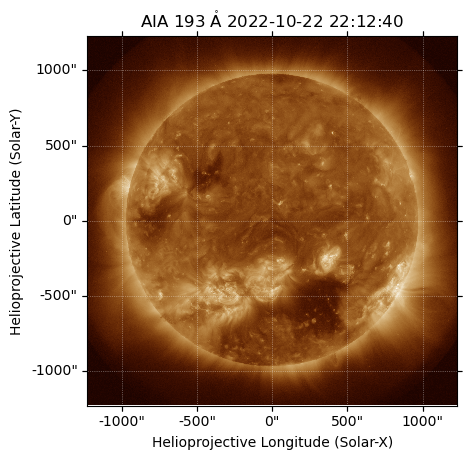

In [3]:
aia_193_map_eis = sunpy.map.Map("../../src/AIA/20221022/193/lvl15/aia_lev15_193a_2022_10_22t22_12_40_84z_image_lev15.fits")
aia_193_map_eis.plot()

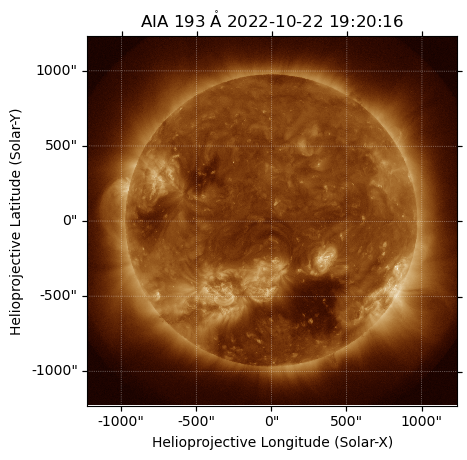

In [4]:
aia_193_map = sunpy.map.Map("../../src/AIA/20221022/193/lvl1/aia_lev1_193a_2022_10_22t19_20_16_83z_image_lev1.fits")
aia_193_map.plot()

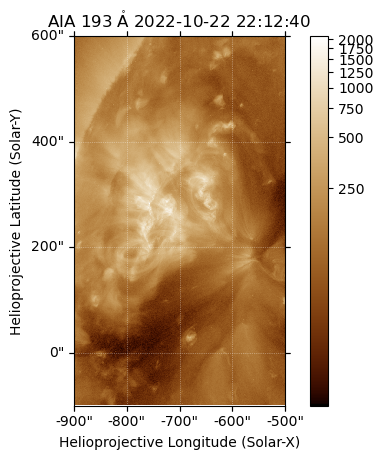

In [5]:
aia_193_map_eis_crop = aia_193_map_eis.submap(SkyCoord(-900*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis.coordinate_frame),
                                        top_right=SkyCoord(-500*u.arcsec,600*u.arcsec,frame=aia_193_map_eis.coordinate_frame))
aia_193_map_eis_crop.plot()
plt.colorbar()

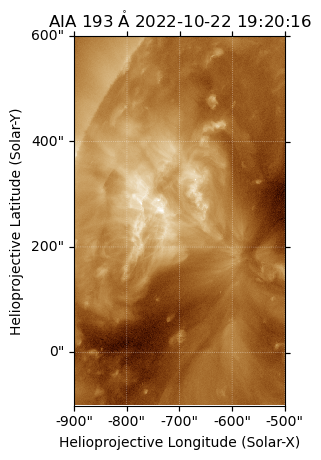

In [6]:
aia_193_map_crop = aia_193_map.submap(SkyCoord(-900*u.arcsec,-100*u.arcsec,frame=aia_193_map.coordinate_frame),
                                        top_right=SkyCoord(-500*u.arcsec,600*u.arcsec,frame=aia_193_map.coordinate_frame))
aia_193_map_crop.plot()

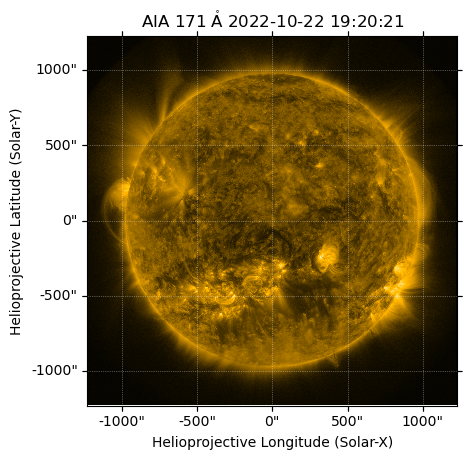

In [7]:
aia_171_map = sunpy.map.Map("../../src/AIA/20221022/171/lvl15/aia_lev15_171a_2022_10_22t19_20_21_34z_image_lev15.fits")
aia_171_map.plot()

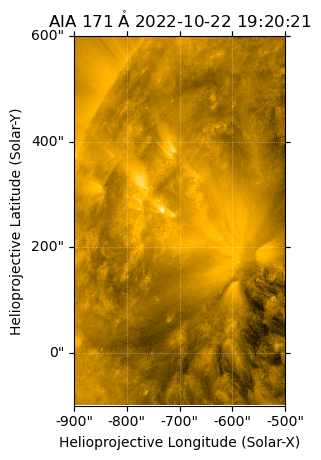

In [8]:
aia_171_map_crop = aia_171_map.submap(SkyCoord(-900*u.arcsec,-100*u.arcsec,frame=aia_171_map.coordinate_frame),
                                        top_right=SkyCoord(-500*u.arcsec,600*u.arcsec,frame=aia_171_map.coordinate_frame))
aia_171_map_crop.plot()

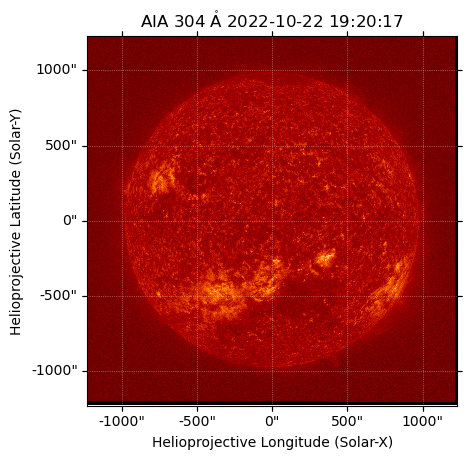

In [9]:
aia_304_map = sunpy.map.Map("../../src/AIA/20221022/304/lvl15/aia_lev15_304a_2022_10_22t19_20_17_13z_image_lev15.fits")
aia_304_map.plot()

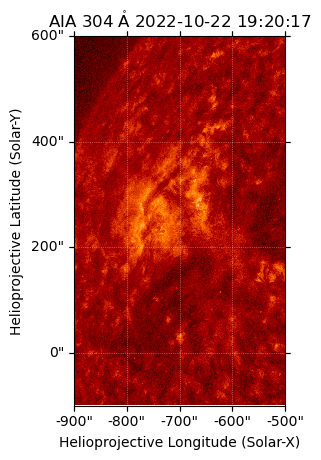

In [10]:
aia_304_map_crop = aia_304_map.submap(SkyCoord(-900*u.arcsec,-100*u.arcsec,frame=aia_304_map.coordinate_frame),
                                        top_right=SkyCoord(-500*u.arcsec,600*u.arcsec,frame=aia_304_map.coordinate_frame))
aia_304_map_crop.plot()

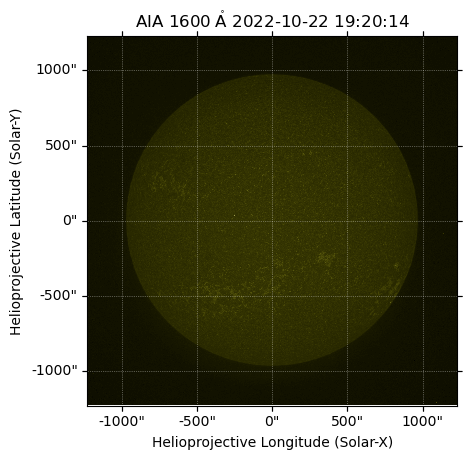

In [11]:
aia_1600_map = sunpy.map.Map("../../src/AIA/20221022/1600/lvl15/aia_lev15_1600a_2022_10_22t19_20_14_13z_image_lev15.fits")
aia_1600_map.plot()

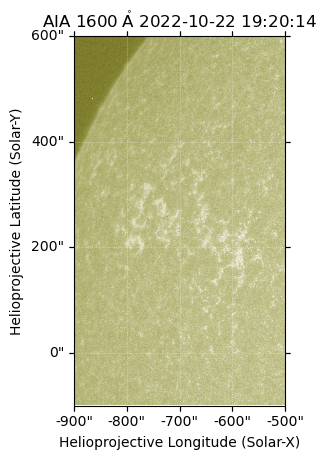

In [12]:
aia_1600_map_crop = aia_1600_map.submap(SkyCoord(-900*u.arcsec,-100*u.arcsec,frame=aia_1600_map.coordinate_frame),
                                        top_right=SkyCoord(-500*u.arcsec,600*u.arcsec,frame=aia_1600_map.coordinate_frame))
aia_1600_map_crop.plot()

In [13]:
aia_304_map_arcutout = aia_304_map.submap(SkyCoord(-800*u.arcsec,100*u.arcsec,frame=aia_304_map.coordinate_frame),
                                        top_right=SkyCoord(-600*u.arcsec,500*u.arcsec,frame=aia_304_map.coordinate_frame))

aia_171_map_arcutout = aia_171_map.submap(SkyCoord(-800*u.arcsec,100*u.arcsec,frame=aia_171_map.coordinate_frame),
                                        top_right=SkyCoord(-600*u.arcsec,500*u.arcsec,frame=aia_171_map.coordinate_frame))

aia_193_map_arcutout = aia_193_map.submap(SkyCoord(-800*u.arcsec,100*u.arcsec,frame=aia_193_map.coordinate_frame),  
                                        top_right=SkyCoord(-600*u.arcsec,500*u.arcsec,frame=aia_193_map.coordinate_frame))

aia_1600_map_arcutout = aia_1600_map.submap(SkyCoord(-800*u.arcsec,100*u.arcsec,frame=aia_1600_map.coordinate_frame),
                                        top_right=SkyCoord(-600*u.arcsec,500*u.arcsec,frame=aia_1600_map.coordinate_frame))

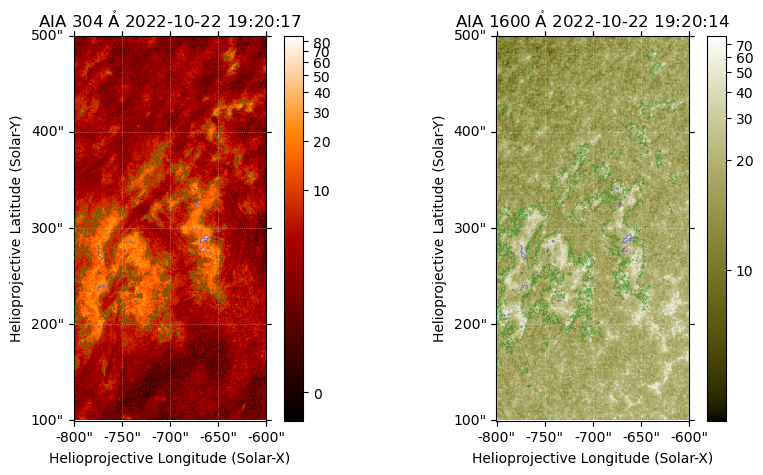

In [14]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(121,projection=aia_304_map_arcutout)
im1 = aia_304_map_arcutout.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_1600_map_arcutout)
im2 = aia_1600_map_arcutout.plot()
plt.colorbar(ax=ax2)

aia_304_levels = [10,30,50]*aia_304_map_crop.unit
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_304_map_crop.draw_contours(levels=aia_304_levels,axes=ax_,colors=["g","b","r"],alpha=0.5,linewidths=0.5)
    ax_.axis(bounds)

In [15]:
SunBlinker(aia_304_map_arcutout, aia_1600_map_arcutout)

In [16]:
def coalign_shift(big_map, small_map):
    yshift, xshift = coalignment._calculate_shift(big_map.data, small_map.data)
    reference_coord = big_map.pixel_to_world(xshift, yshift)
    Txshift = reference_coord.Tx - small_map.bottom_left_coord.Tx
    Tyshift = reference_coord.Ty - small_map.bottom_left_coord.Ty

    return Txshift, Tyshift
    

In [17]:
aia_1600_to_304_Txshift, aia_1600_to_304_Tyshift = coalign_shift(aia_304_map_crop,aia_1600_map.reproject_to(aia_304_map_arcutout.wcs,algorithm="exact"))

In [18]:
aia_1600_map_arcutout_shifted = aia_1600_map_arcutout.shift_reference_coord(aia_1600_to_304_Txshift,aia_1600_to_304_Tyshift)
aia_1600_map_shifted = aia_1600_map.shift_reference_coord(aia_1600_to_304_Txshift,aia_1600_to_304_Tyshift)

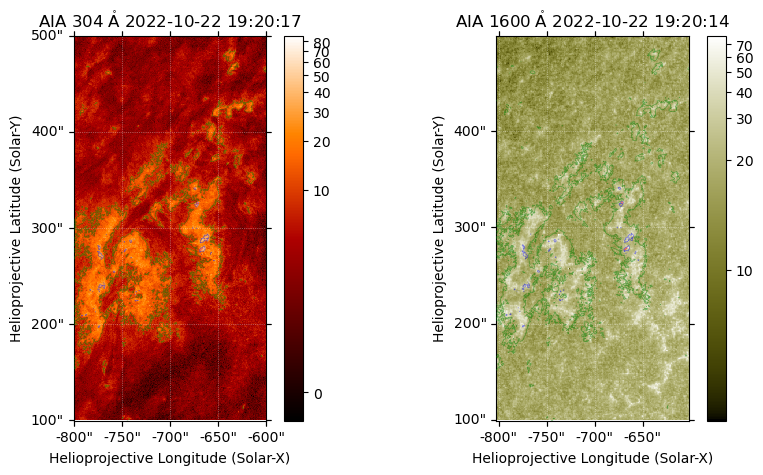

In [19]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(121,projection=aia_304_map_arcutout)
im1 = aia_304_map_arcutout.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_1600_map_arcutout_shifted)
im2 = aia_1600_map_arcutout_shifted.plot()
plt.colorbar(ax=ax2)

aia_304_levels = [10,30,50]*aia_304_map_crop.unit
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_304_map_crop.draw_contours(levels=aia_304_levels,axes=ax_,colors=["g","b","r"],alpha=0.5,linewidths=0.5)
    ax_.axis(bounds)

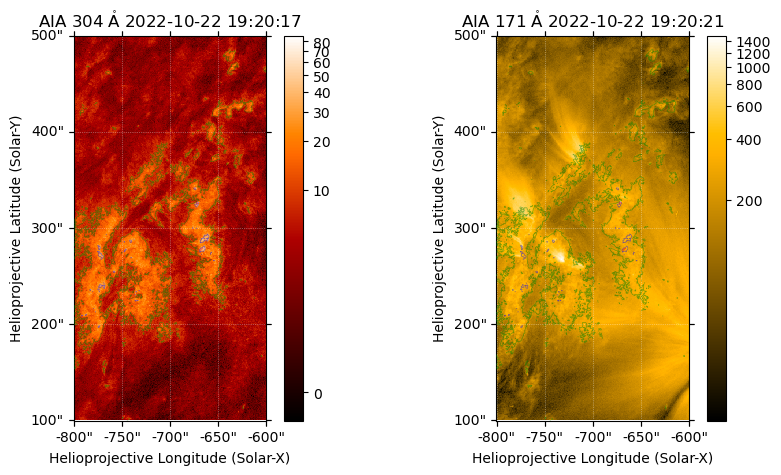

In [20]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(121,projection=aia_304_map_arcutout)
im1 = aia_304_map_arcutout.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_171_map_arcutout)
im2 = aia_171_map_arcutout.plot()
plt.colorbar(ax=ax2)

aia_304_levels = [10,30,50]*aia_304_map_crop.unit
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_304_map_crop.draw_contours(levels=aia_304_levels,axes=ax_,colors=["g","b","r"],alpha=0.5,linewidths=0.5)
    ax_.axis(bounds)

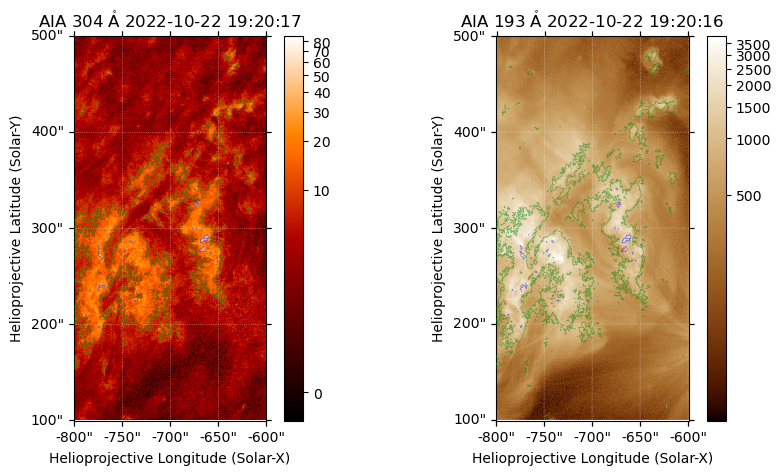

In [21]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(121,projection=aia_304_map_arcutout)
im1 = aia_304_map_arcutout.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_arcutout)
im2 = aia_193_map_arcutout.plot()
plt.colorbar(ax=ax2)

aia_304_levels = [10,30,50]*aia_304_map_crop.unit
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_304_map_crop.draw_contours(levels=aia_304_levels,axes=ax_,colors=["g","b","r"],alpha=0.5,linewidths=0.5)
    ax_.axis(bounds)

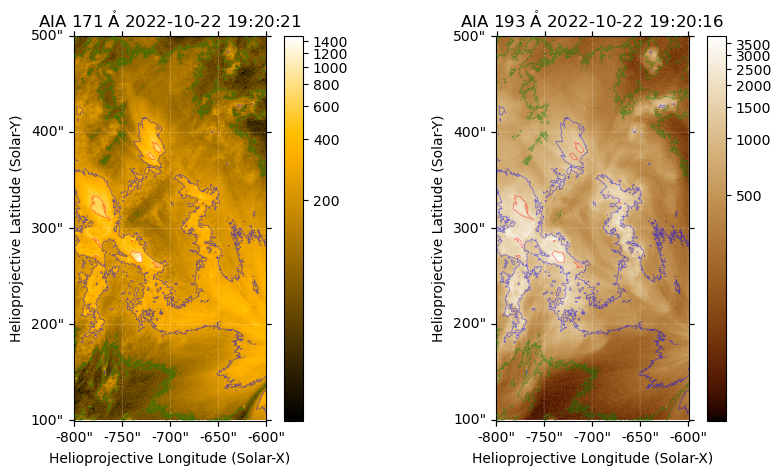

In [22]:
fig = plt.figure(figsize=(10,5))
ax1 = fig.add_subplot(121,projection=aia_171_map_arcutout)
im1 = aia_171_map_arcutout.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_arcutout)
im2 = aia_193_map_arcutout.plot()
plt.colorbar(ax=ax2)

aia_171_levels = [100,250,600]*aia_171_map_crop.unit
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_171_map_crop.draw_contours(levels=aia_171_levels,axes=ax_,colors=["g","b","r"],alpha=0.5,linewidths=0.5)
    ax_.axis(bounds)

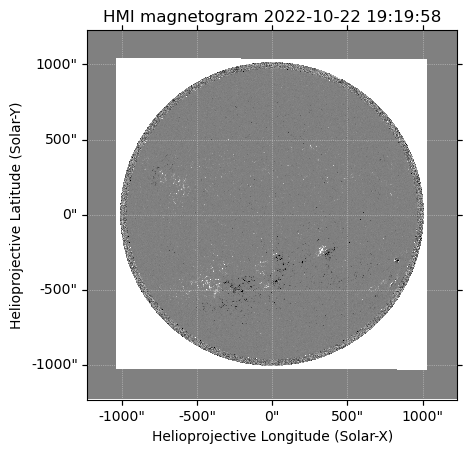

In [23]:
hmi_los_map = sunpy.map.Map("../../src/HMI/20221022/lvl15/hmi.M_45s.20221022_192100_TAI.2.magnetogram.fits")
hmi_los_map.plot_settings['norm'] = plt.Normalize(-500, 500)
hmi_los_map.plot()

In [24]:
hmi_los_map_to_aia = hmi_los_map

In [25]:
hmi_los_map_to_aia_crop = hmi_los_map_to_aia.submap(SkyCoord(-900*u.arcsec,-100*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame),
                                        top_right=SkyCoord(-500*u.arcsec,600*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame))

hmi_los_map_to_aia_arcutout = hmi_los_map_to_aia.submap(SkyCoord(-800*u.arcsec,100*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame),
                                        top_right=SkyCoord(-600*u.arcsec,500*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame))

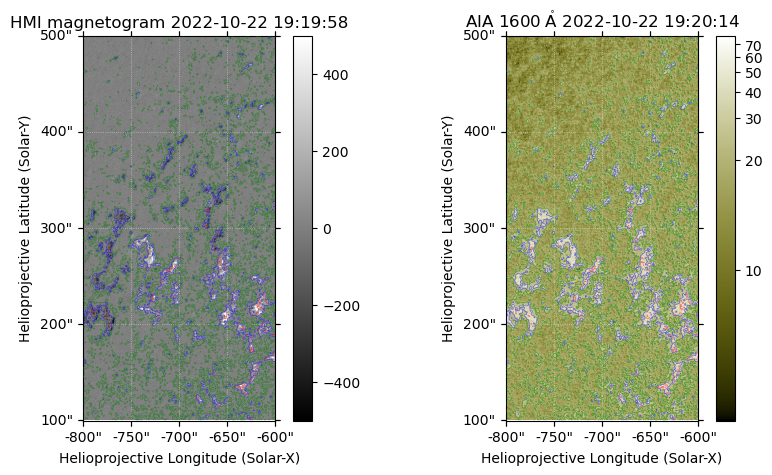

In [26]:
fig = plt.figure(figsize=(10,5))

ax1 = fig.add_subplot(121,projection=hmi_los_map_to_aia_arcutout)
im1 = hmi_los_map_to_aia_arcutout.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_1600_map_arcutout)
im2 = aia_1600_map_arcutout.plot()
plt.colorbar(ax=ax2)

aia_1600_levels = [20,30,50]*aia_1600_map_arcutout.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_1600_map_arcutout.draw_contours(levels=aia_1600_levels,axes=ax_,colors=["g","b","r"],alpha=0.5,linewidths=0.5)
    ax_.axis(bounds)

In [27]:
SunBlinker(hmi_los_map_to_aia_arcutout,aia_1600_map_arcutout)

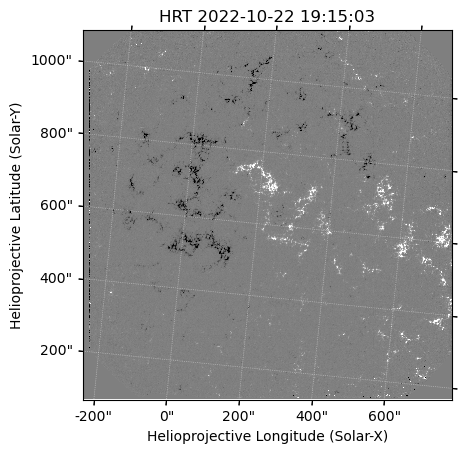

In [28]:
phi_los_map = sunpy.map.Map("../../src/PHI/20221022/solo_L2_phi-hrt-blos_20221022T191503_V01.fits")
phi_los_map.plot_settings['norm'] = plt.Normalize(-500, 500)
phi_los_map.plot()

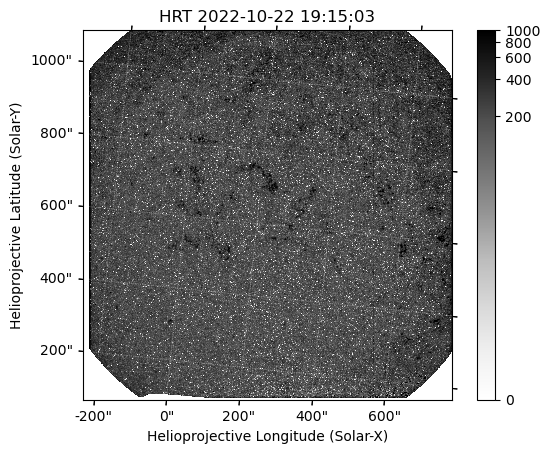

In [29]:
phi_btot_map = sunpy.map.Map("../../src/PHI/20221022/solo_L2_phi-hrt-bmag_20221022T191503_V01.fits")
phi_btot_map.plot(norm=ImageNormalize(vmin=0,vmax=1000,stretch=LogStretch()),cmap="Greys")
plt.colorbar()

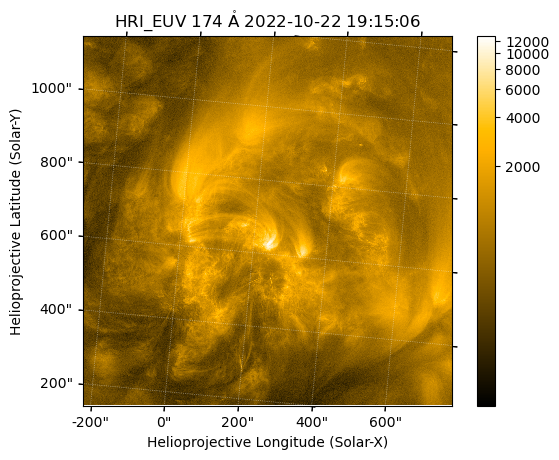

In [83]:
hri_174_map = sunpy.map.Map("../../src/EUI/HRI/euv174/20221022/solo_L2_eui-hrieuv174-image_20221022T191505252_V01.fits")
hri_174_map.meta['rsun_ref'] = aia_1600_map.meta['rsun_ref']
hri_174_map.plot()
plt.colorbar()

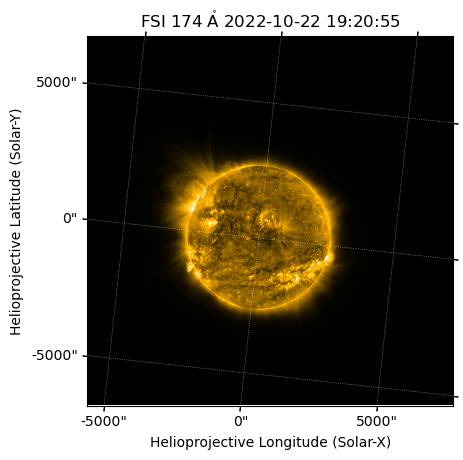

In [84]:
fsi_174_map = sunpy.map.Map("../../src/EUI/FSI/euv174/20221022/solo_L2_eui-fsi174-image_20221022T192050259_V01.fits")
fsi_174_map.meta['rsun_ref'] = aia_1600_map.meta['rsun_ref']
fsi_174_map.plot()

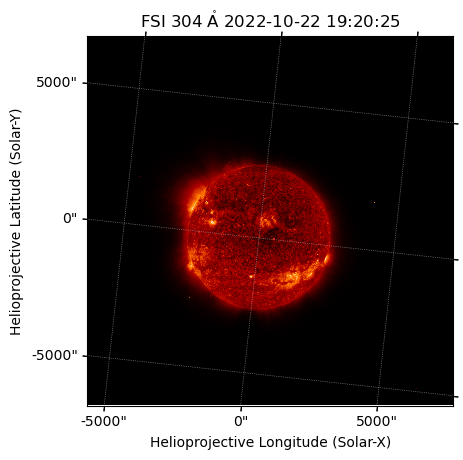

In [85]:
fsi_304_map = sunpy.map.Map("../../src/EUI/FSI/euv304/20221022/solo_L2_eui-fsi304-image_20221022T192020259_V01.fits")
fsi_304_map.meta['rsun_ref'] = aia_1600_map.meta['rsun_ref']
fsi_304_map.plot()

Reading fit result from, 
   ../../src/EIS/DHB_007_v2/20221022T2140/eis_20221022_214043.fe_12_195_119.1c-0.fit.h5
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


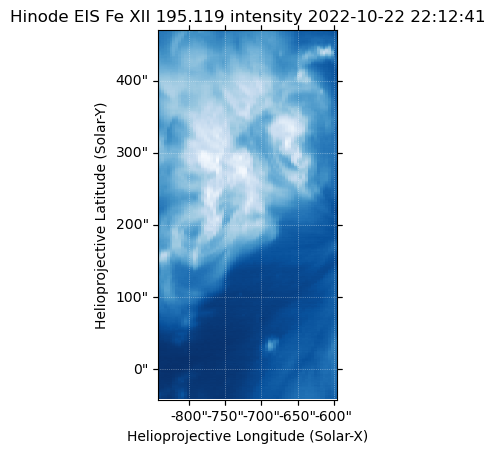

In [86]:
eis_195_fitres = eispac.read_fit("../../src/EIS/DHB_007_v2/20221022T2140/eis_20221022_214043.fe_12_195_119.1c-0.fit.h5")
eis_195_intmap = eis_195_fitres.get_map(component=0,measurement="intensity")
eis_195_intmap.meta['rsun_ref'] = aia_1600_map.meta['rsun_ref']
eis_195_intmap.plot()

In [87]:
aia_resample_nx = (aia_193_map_eis_crop.scale.axis1 * aia_193_map_eis_crop.dimensions.x) / eis_195_intmap.scale.axis1
aia_resample_ny = (aia_193_map_eis_crop.scale.axis2 * aia_193_map_eis_crop.dimensions.y) / eis_195_intmap.scale.axis2
aia_193_map_resample = aia_193_map_eis_crop.resample(u.Quantity([aia_resample_nx, aia_resample_ny]))

In [88]:
eis_to_aia_Txshift, eis_to_aia_Tyshift = coalign_shift(aia_193_map_resample,eis_195_intmap)
print(eis_to_aia_Txshift)
print(eis_to_aia_Tyshift)
eis_195_intmap_shift = eis_195_intmap.shift_reference_coord(eis_to_aia_Txshift,eis_to_aia_Tyshift)

3.46629 arcsec
-6.67951 arcsec


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


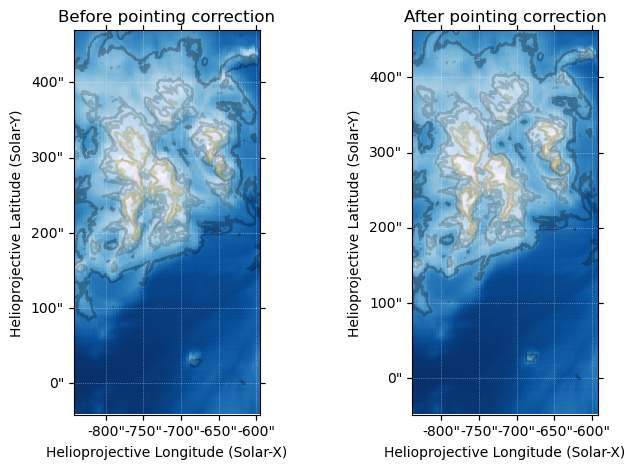

In [36]:
fig = plt.figure(figsize=(8,5))
ax1 = fig.add_subplot(121,projection=eis_195_intmap)
eis_195_intmap.plot(axes=ax1, title='Before pointing correction')

ax2 = fig.add_subplot(122,projection=eis_195_intmap_shift)
eis_195_intmap_shift.plot(axes=ax2, title='After pointing correction')

aia_levels = [200, 400, 500, 700, 800, 1200] * aia_193_map_eis.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_eis.draw_contours(aia_levels, axes=ax_, cmap=cmcm.batlowK, alpha=0.3)
    ax_.axis(bounds)

In [37]:
with propagate_with_solar_surface():
    aia_193_map_eis_derot = aia_193_map_eis.reproject_to(aia_193_map.wcs)

In [38]:
# aia_193_map_compare = aia_193_map.submap(SkyCoord(-900*u.arcsec,-100*u.arcsec,frame=aia_193_map.coordinate_frame),
#                                         top_right=SkyCoord(-500*u.arcsec,600*u.arcsec,frame=aia_193_map.coordinate_frame))

aia_193_map_eis_compare = aia_193_map_eis_derot.submap(SkyCoord(-900*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis_derot.coordinate_frame),
                                        top_right=SkyCoord(-500*u.arcsec,600*u.arcsec,frame=aia_193_map_eis_derot.coordinate_frame))

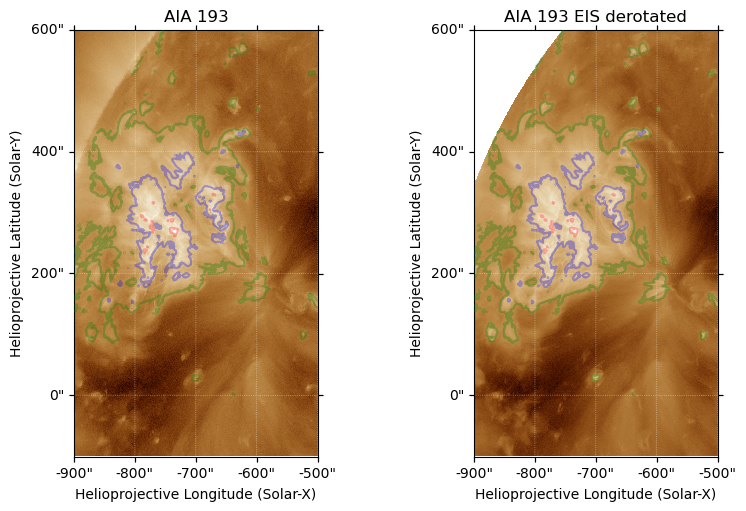

In [39]:
fig = plt.figure(figsize=(8,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
aia_193_map_crop.plot(axes=ax1, title='AIA 193')

ax2 = fig.add_subplot(122,projection=aia_193_map_eis_compare)
aia_193_map_eis_compare.plot(axes=ax2, title='AIA 193 EIS derotated')

aia_levels = [200, 500, 1200] 

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_eis_compare.draw_contours(aia_levels, axes=ax_, colors=["g","b","r"], alpha=0.3)
    ax_.axis(bounds)

In [40]:
SunBlinker(aia_193_map_crop, aia_193_map_eis_compare)


In [89]:
def derotate_fsi(fsi_map, hri_map,algorithm="adaptive"):
    out_frame = hri_map.coordinate_frame
    out_center = SkyCoord(0*u.arcsec, 0*u.arcsec, frame=out_frame)
    header = sunpy.map.make_fitswcs_header(fsi_map.data.shape,
                                        out_center,
                                        scale=u.Quantity(fsi_map.scale),
                                        rotation_matrix=fsi_map.rotation_matrix,
                                        )
    out_wcs = WCS(header)

    with propagate_with_solar_surface():
        fsi_map_derot = fsi_map.reproject_to(out_wcs,algorithm=algorithm)

    return fsi_map_derot


In [90]:
fsi_174_map_hri_time = derotate_fsi(fsi_174_map,hri_174_map)

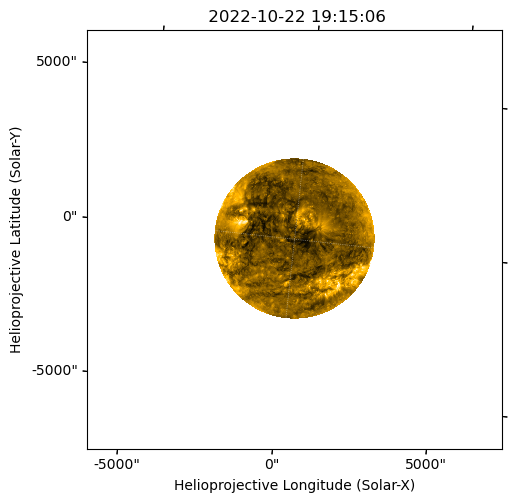

In [91]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)

ax1 = fig.add_subplot(111,projection=fsi_174_map_hri_time)
fsi_174_map_hri_time.plot()

In [92]:
fsi_174_crop = fsi_174_map_hri_time.submap(SkyCoord(-500*u.arcsec,0*u.arcsec,frame=fsi_174_map_hri_time.coordinate_frame),
                                    top_right=SkyCoord(1000*u.arcsec,1500*u.arcsec,frame=fsi_174_map_hri_time.coordinate_frame))

In [93]:
hri_174_map_rotate_to_fsi_wcs = deepcopy(hri_174_map.wcs)
hri_174_map_rotate_to_fsi_wcs.wcs.pc = fsi_174_map_hri_time.wcs.wcs.pc
hri_174_map_rotate_to_fsi_wcs

WCS Keywords

Number of WCS axes: 2
CTYPE : 'HPLN-TAN' 'HPLT-TAN' 
CRVAL : 0.047761701060542 0.18136850655079 
CRPIX : 896.5 960.5 
PC1_1 PC1_2  : 0.99403334182531 -0.10907664891991 
PC2_1 PC2_2  : 0.10907664891991 0.99403334182531 
CDELT : 0.00013666666666667 0.00013666666666667 
NAXIS : 2048  2048

In [94]:
hri_174_map_correct_rot_matrix = hri_174_map.reproject_to(hri_174_map_rotate_to_fsi_wcs)

In [95]:
hri_174_map_repro = hri_174_map_correct_rot_matrix.reproject_to(fsi_174_crop.wcs)

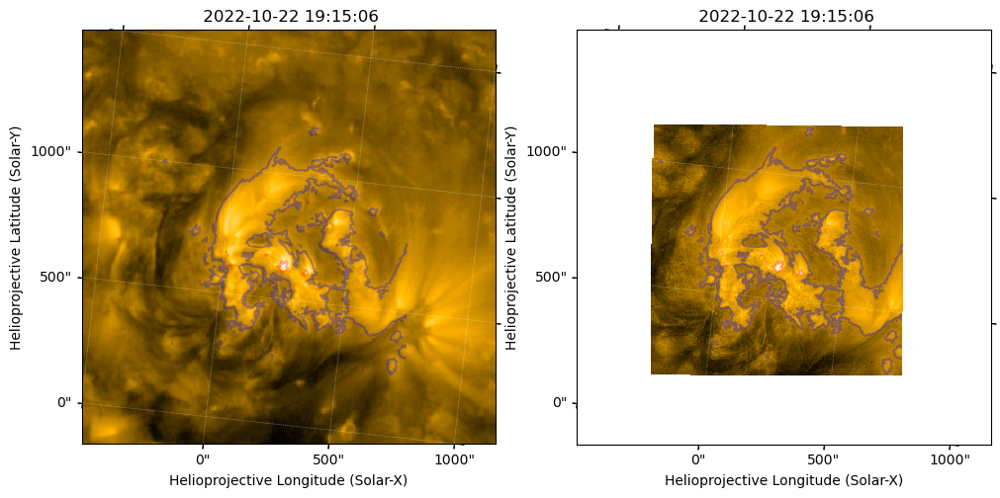

In [96]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_crop)
im1 = fsi_174_crop.plot()

ax2 = fig.add_subplot(122,projection=hri_174_map_repro)
im2 = hri_174_map_repro.plot()

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_repro.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


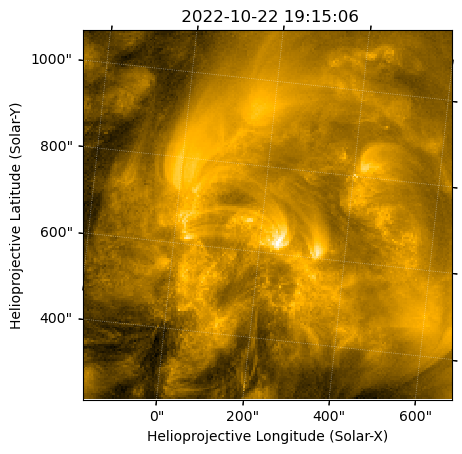

In [97]:
hri_174_map_repro_cut = hri_174_map_repro.submap([79,77]*u.pix,
                                                 top_right=[272,270]*u.pix)
hri_174_map_repro_cut.plot()

In [98]:
Txshift_hri, Tyshift_hri = coalign_shift(fsi_174_crop,hri_174_map_repro_cut)
print(Txshift_hri, Tyshift_hri)

6.59945 arcsec 8.15792 arcsec


In [99]:
hri_174_map_repro_shift = hri_174_map_repro.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_repro_cut_shift = hri_174_map_repro_cut.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_shifted = hri_174_map_correct_rot_matrix.shift_reference_coord(Txshift_hri,Tyshift_hri)
fsi_174_hri_fov = fsi_174_map_hri_time.reproject_to(hri_174_map_shifted.wcs)

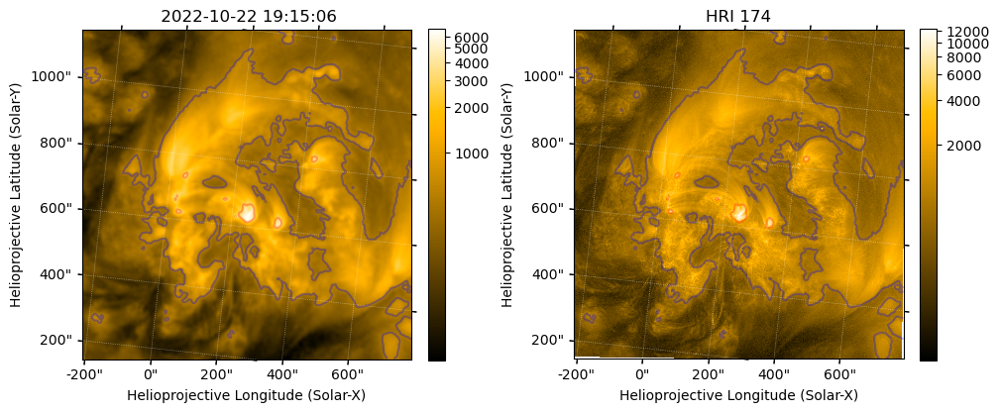

In [100]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_hri_fov)
im1 = fsi_174_hri_fov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
ax2.set_title("HRI 174")
plt.colorbar(ax=ax2,shrink=0.75)

fsi_174_levels = [500,3000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_174_hri_fov.draw_contours(fsi_174_levels,colors=["b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

In [101]:
SunBlinker(fsi_174_hri_fov, hri_174_map_shifted,figsize=(5,5))

In [102]:
hri_174_map_shifted.rotation_matrix, fsi_174_crop.rotation_matrix

(array([[ 0.99403334, -0.10907665],
        [ 0.10907665,  0.99403334]]),
 array([[ 0.99403334, -0.10907665],
        [ 0.10907665,  0.99403334]]))

In [103]:
fsi_304_map_hri_time = derotate_fsi(fsi_304_map,hri_174_map)

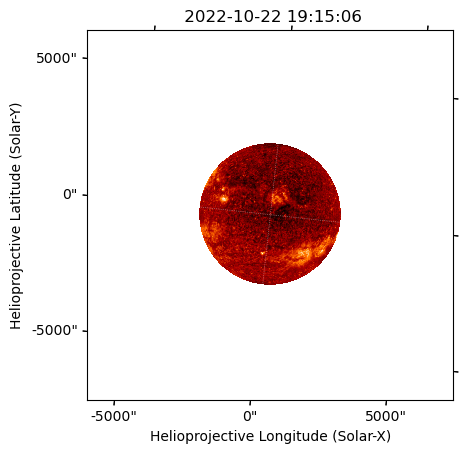

In [104]:
fsi_304_map_hri_time.plot()

In [105]:
fsi_304_crop = fsi_304_map_hri_time.submap(SkyCoord(-500*u.arcsec,0*u.arcsec,frame=fsi_304_map_hri_time.coordinate_frame),
                                    top_right=SkyCoord(1000*u.arcsec,1500*u.arcsec,frame=fsi_304_map_hri_time.coordinate_frame))

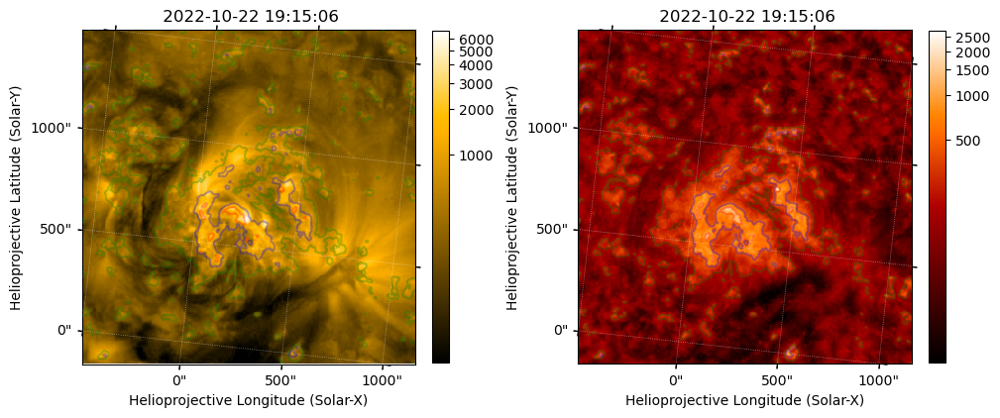

In [106]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_crop)
im1 = fsi_174_crop.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [107]:
SunBlinker(fsi_174_crop, fsi_304_crop)

In [108]:
aia_304_map_repro = aia_304_map.reproject_to(fsi_304_crop.wcs)

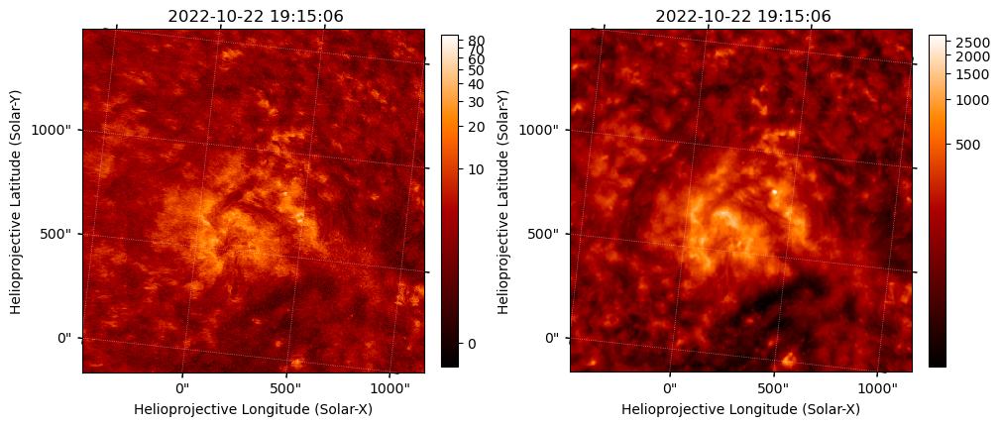

In [109]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro)
im1 = aia_304_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

# fsi_304_levels = [200,500,1000]

# for ax_ in (ax1,ax2):
#     bounds = ax_.axis()
#     fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
#     ax_.axis(bounds)


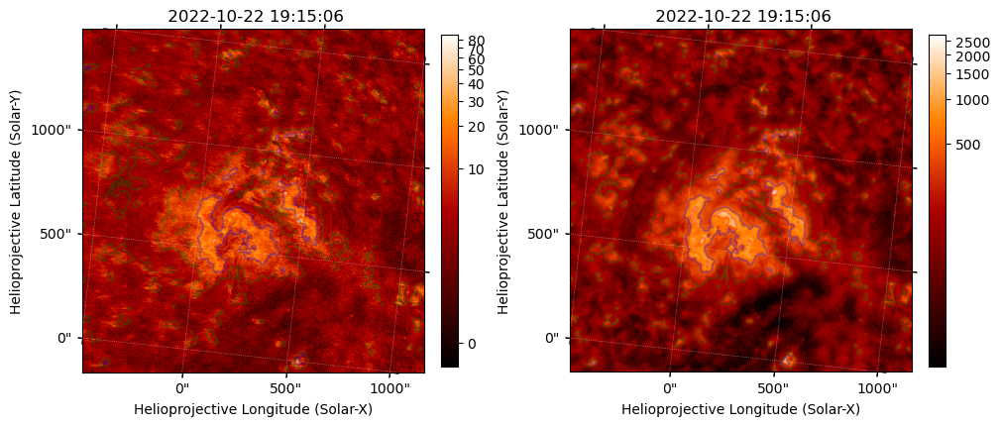

In [110]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro)
im1 = aia_304_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


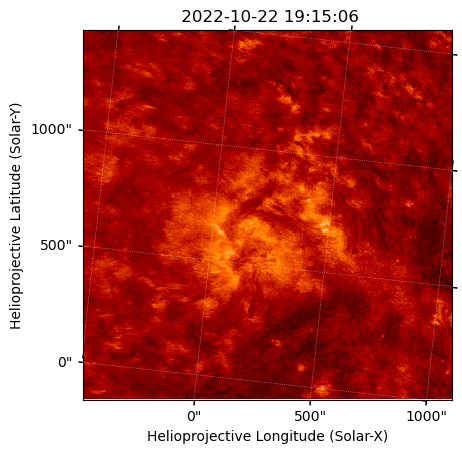

In [111]:
aia_304_map_repro_cut = aia_304_map_repro.submap([1,1]*u.pix,
                                                    top_right=[360,360]*u.pix)
aia_304_map_repro_cut.plot()

In [112]:
Txshift_aia_fsi, Tyshift_aia_fsi = coalign_shift(fsi_304_crop,aia_304_map_repro_cut)
print(Txshift_aia_fsi, Tyshift_aia_fsi)

14.6244 arcsec 3.37227 arcsec


In [113]:
aia_304_map_repro_shift = aia_304_map_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)

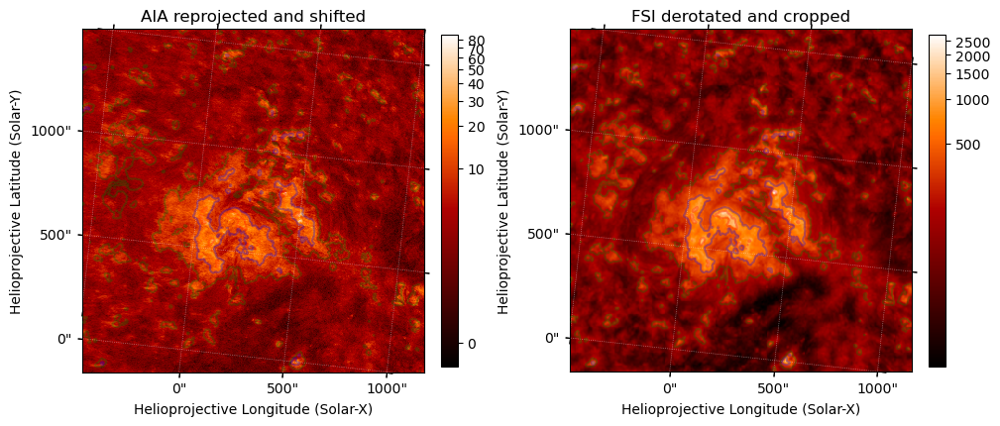

In [114]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro_shift)
im1 = aia_304_map_repro_shift.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA reprojected and shifted")

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("FSI derotated and cropped")

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [115]:
SunBlinker(aia_304_map_repro_shift, fsi_304_map_hri_time, reproject=True)

In [116]:
aia_1600_map_repro = aia_1600_map.reproject_to(fsi_304_crop.wcs)

In [117]:
aia_1600_map_repro_shift = aia_1600_map_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)

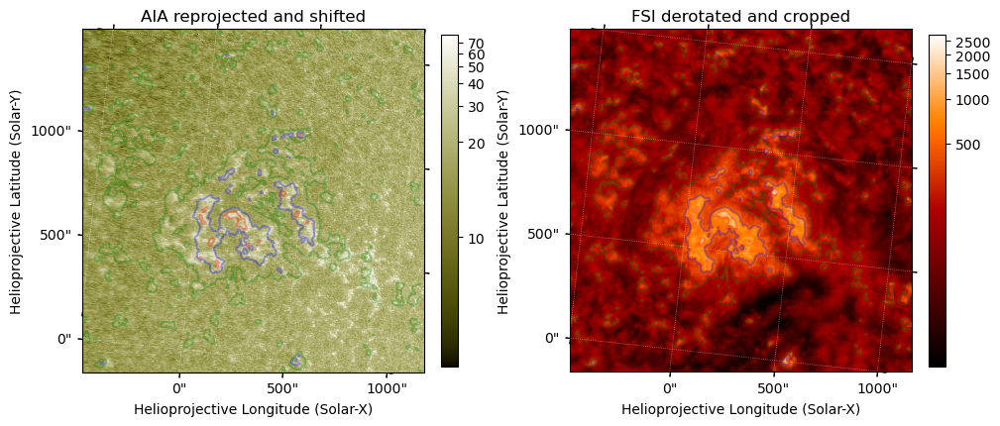

In [118]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_1600_map_repro_shift)
im1 = aia_1600_map_repro_shift.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA reprojected and shifted")

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("FSI derotated and cropped")

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [119]:
SunBlinker(aia_1600_map_repro_shift, fsi_304_crop)

In [120]:
aia_171_repro = aia_171_map.reproject_to(fsi_304_crop.wcs)
aia_171_repro_shift = aia_171_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)

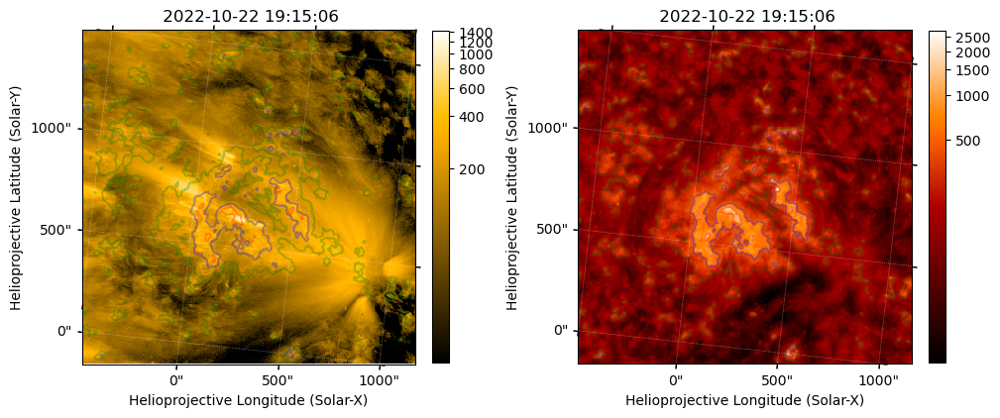

In [121]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_171_repro_shift)
im1 = aia_171_repro_shift.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

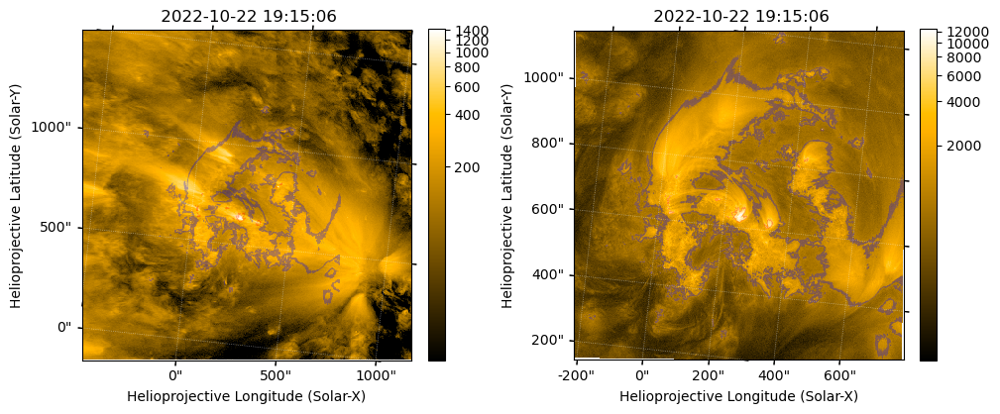

In [122]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_171_repro_shift)
im1 = aia_171_repro_shift.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [123]:
aia_171_repro_shift_hrifov = aia_171_repro_shift.reproject_to(hri_174_map_shifted.wcs)

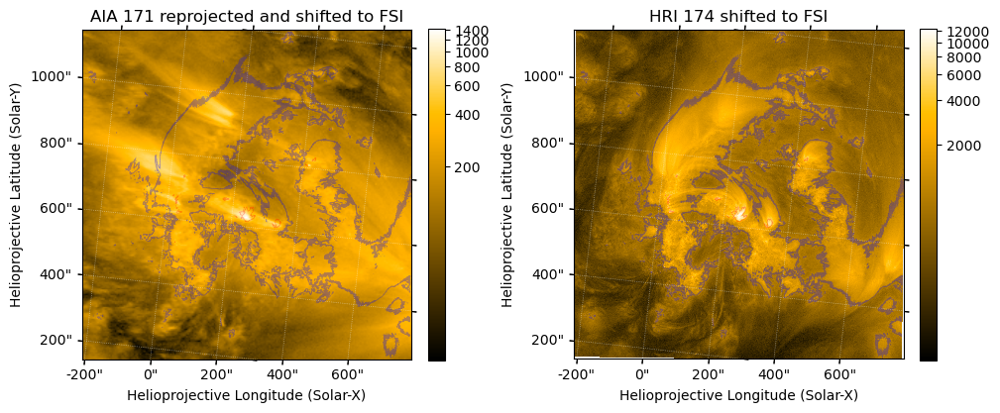

In [124]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_171_repro_shift_hrifov)
im1 = aia_171_repro_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA 171 reprojected and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("HRI 174 shifted to FSI")

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [125]:
SunBlinker(aia_171_repro_shift_hrifov, hri_174_map_shifted)

In [126]:
aia_193_repro = aia_193_map.reproject_to(fsi_304_crop.wcs)
aia_193_repro_shift = aia_193_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)
aia_193_repro_shift_hrifov = aia_193_repro_shift.reproject_to(hri_174_map_shifted.wcs)

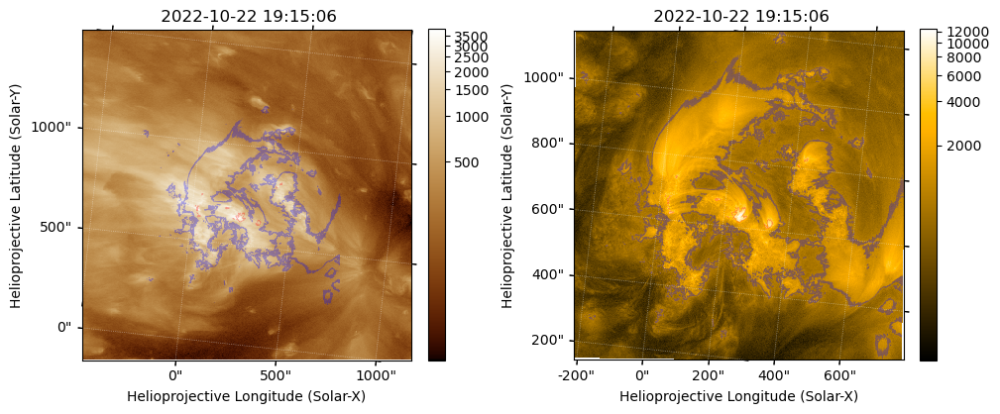

In [127]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_repro_shift)
im1 = aia_193_repro_shift.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

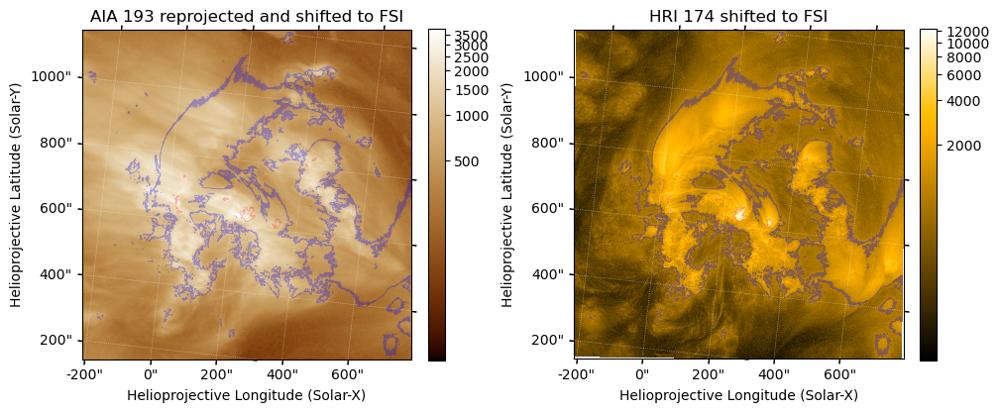

In [128]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_repro_shift_hrifov)
im1 = aia_193_repro_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA 193 reprojected and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("HRI 174 shifted to FSI")

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [129]:
SunBlinker(aia_193_repro_shift_hrifov, hri_174_map_shifted)

In [130]:
hmi_los_map_repro = hmi_los_map_to_aia.reproject_to(fsi_304_crop.wcs)
hmi_los_map_repro_shift = hmi_los_map_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)
hmi_los_map_repro_shift_hrifov = hmi_los_map_repro_shift.reproject_to(hri_174_map_shifted.wcs)

In [131]:
fsi_304_crop_hrifov = fsi_304_crop.reproject_to(hri_174_map_shifted.wcs)

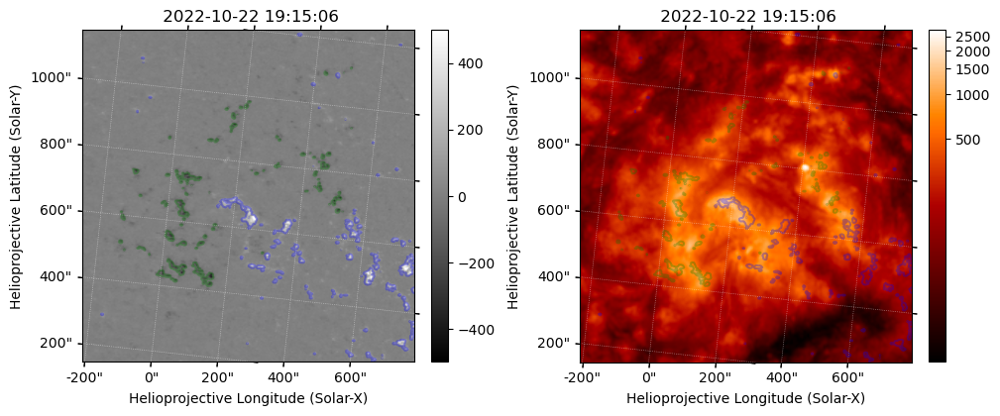

In [132]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hmi_los_map_repro_shift_hrifov)
im1 = hmi_los_map_repro_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop_hrifov)
im2 = fsi_304_crop_hrifov.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels = [-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_shift_hrifov.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)
    

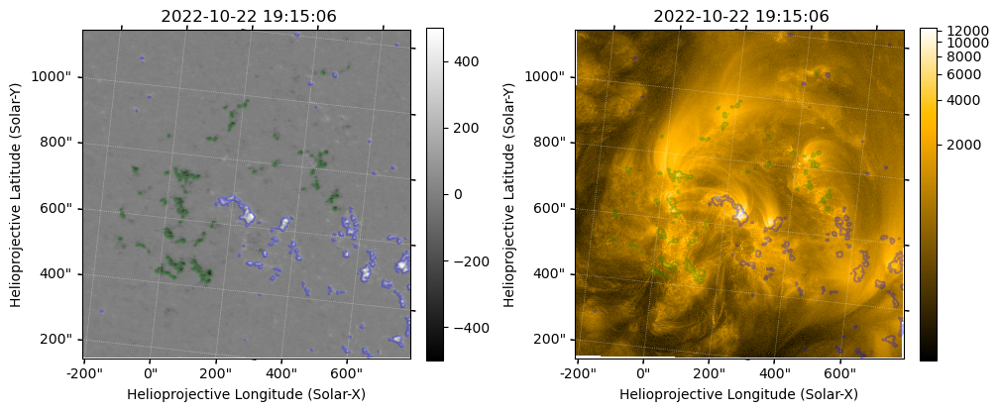

In [133]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hmi_los_map_repro_shift_hrifov)
im1 = hmi_los_map_repro_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels = [-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_shift_hrifov.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)
    
plt.savefig("../../figs/test_figs/hmi_eui_coalign.png",dpi=600)

In [134]:
SunBlinker(hmi_los_map_repro_shift_hrifov, hri_174_map_shifted)

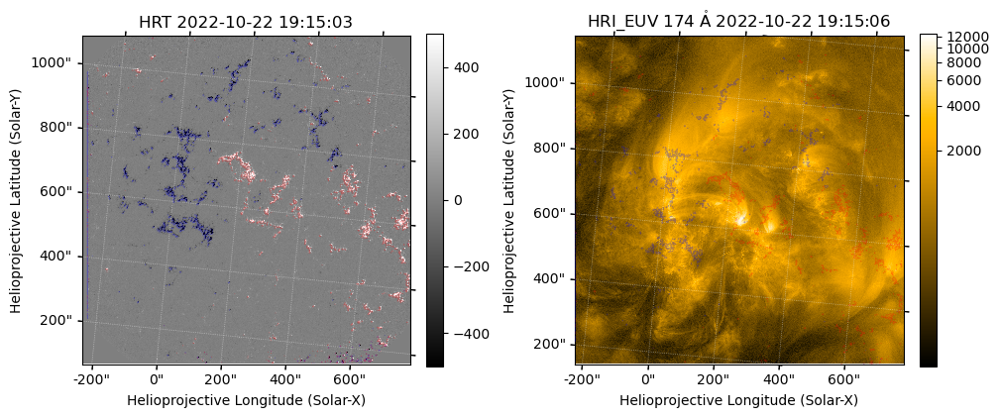

In [135]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map)
im1 = phi_los_map.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map)
im2 = hri_174_map.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]*phi_los_map.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

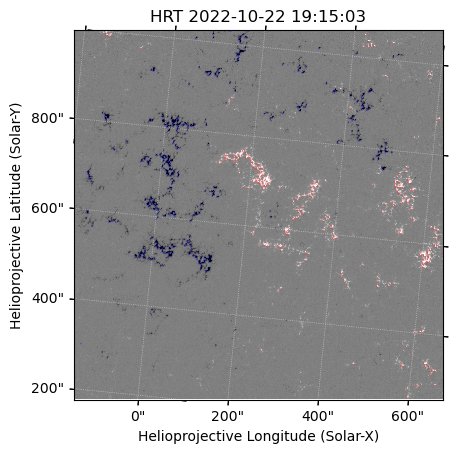

In [136]:
phi_los_map_crop = phi_los_map.submap([200,200]*u.pix,
                                      top_right=[1847,1847]*u.pix)

phi_los_map_crop.plot()
phi_los_map_crop.draw_contours([-300,300]*phi_los_map_crop.unit,colors=["b","r"], alpha=0.3,linewidths=0.5)
plt.savefig("../../figs/test_figs/phi_contour.png",dpi=300)

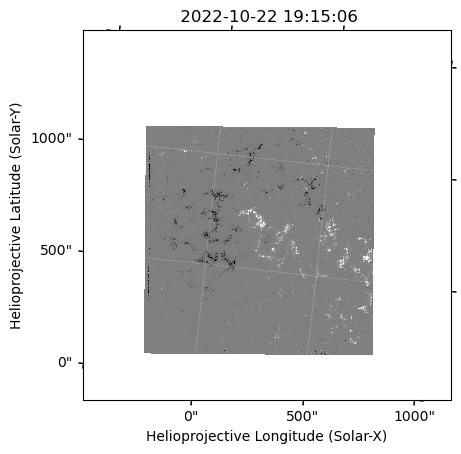

In [137]:
phi_los_map_resample = phi_los_map.reproject_to(fsi_304_crop.wcs)
phi_los_map_resample.plot()

In [138]:
phi_los_map_resample.data.shape

(374, 373)

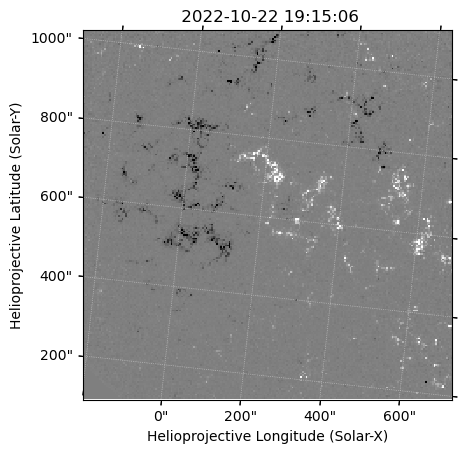

In [139]:
phi_los_map_resample_crop = phi_los_map_resample.submap([70,50]*u.pix,
                                                        top_right=[280,260]*u.pix)
phi_los_map_resample_crop.plot()

In [140]:
Txshift_phi_hmi, Tyshift_phi_hmi = coalign_shift(hmi_los_map_repro_shift,phi_los_map_resample_crop)
print(Txshift_phi_hmi, Tyshift_phi_hmi)

20.6235 arcsec -73.4915 arcsec


In [141]:
phi_los_map_shifted = phi_los_map.shift_reference_coord(Txshift_phi_hmi,Tyshift_phi_hmi)
phi_los_map_shifted_hrifov = phi_los_map_shifted.reproject_to(hri_174_map_shifted.wcs)
phi_los_map_resample_crop_shifted = phi_los_map_resample_crop.shift_reference_coord(Txshift_phi_hmi,Tyshift_phi_hmi)

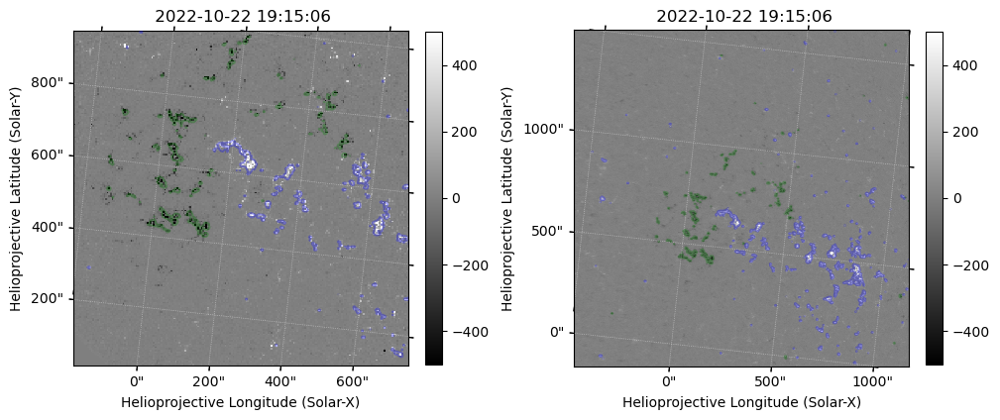

In [142]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_resample_crop_shifted)
im1 = phi_los_map_resample_crop_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro_shift)
im2 = hmi_los_map_repro_shift.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_shift.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

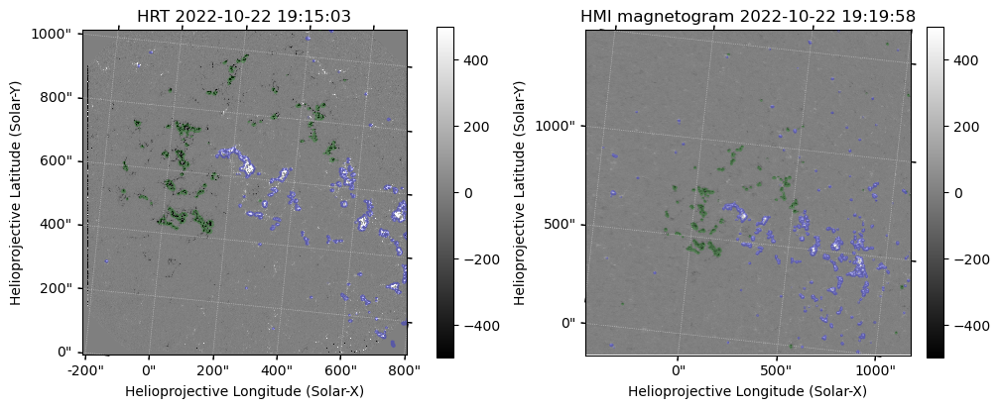

In [143]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted)
im1 = phi_los_map_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro_shift)
im2 = hmi_los_map_repro_shift.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title(hmi_los_map.name)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_shift.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/phi_hmi_coalign.png",dpi=600)

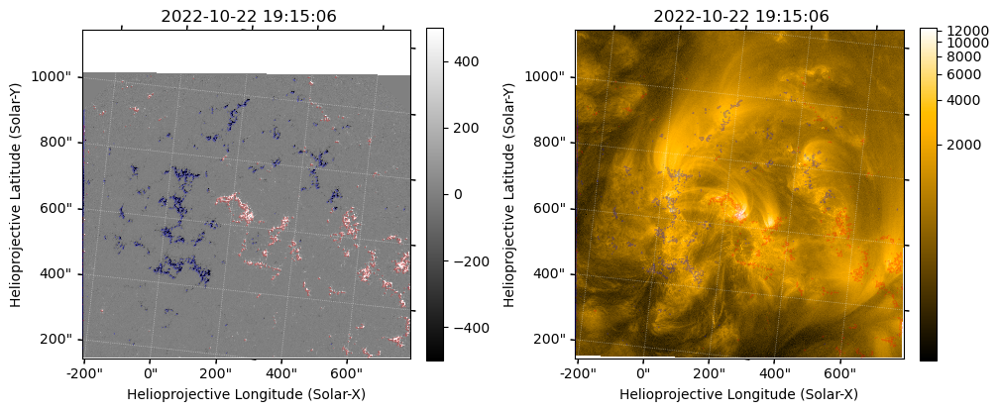

In [144]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted_hrifov)
im1 = phi_los_map_shifted_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map_shifted_hrifov.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/phi_eui_test.png",dpi=600)

In [145]:
SunBlinker(phi_los_map_shifted_hrifov, hmi_los_map_repro_shift_hrifov,figsize=(5,5))

In [147]:
phi_los_map_shifted_hrifov.save("../../src/coalign_map/20221022/phi_los_map_shifted_hrifov.fits",overwrite=True)
phi_los_map_shifted.save("../../src/coalign_map/20221022/phi_los_map_shifted.fits",overwrite=True)

In [138]:
eis_195_velmap = eis_195_fitres.get_map(component=0,measurement="vel")
eis_195_velmap_shift = eis_195_velmap.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)

with propagate_with_solar_surface(rotation_model="rigid"):
    eis_195_intmap_derot = eis_195_intmap_shift.reproject_to(aia_193_map_crop.wcs)
    eis_195_velmap_derot = eis_195_velmap_shift.reproject_to(aia_193_map_crop.wcs)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


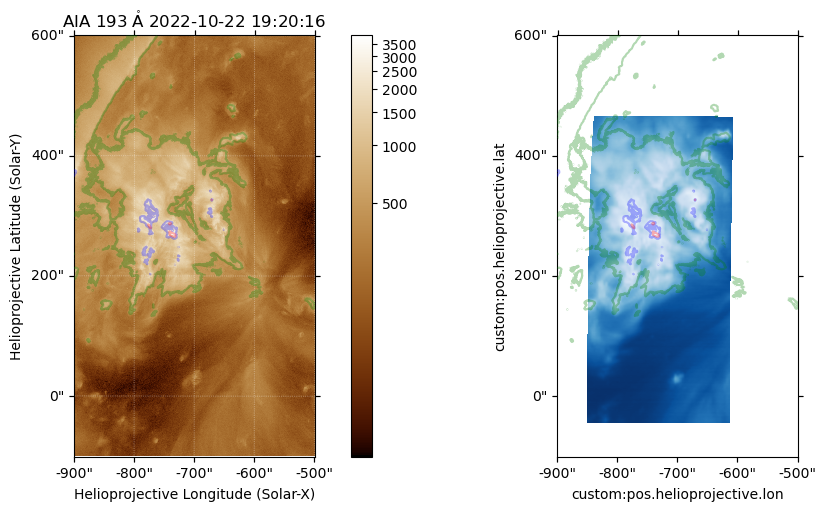

In [139]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
im1 = aia_193_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_crop)
ax2.imshow(eis_195_intmap_derot.data,origin="lower",cmap=eis_195_intmap_derot.plot_settings['cmap'],norm=eis_195_intmap_derot.plot_settings['norm'])

aia_193_levels = [500,2000,3000]*aia_193_map_crop.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_crop.draw_contours(aia_193_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)



In [140]:
SunBlinker(aia_193_map_crop, eis_195_intmap_derot)

In [141]:
eis_195_intmap_derot_repro = eis_195_intmap_derot.reproject_to(fsi_304_crop.wcs)
eis_195_velmap_derot_repro = eis_195_velmap_derot.reproject_to(fsi_304_crop.wcs)

In [142]:
eis_195_intmap_derot_repro_shifted = eis_195_intmap_derot_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)
eis_195_velmap_derot_repro_shifted = eis_195_velmap_derot_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)

In [143]:
eis_195_intmap_derot_repro_shifted_hrifov = eis_195_intmap_derot_repro_shifted.reproject_to(hri_174_map_shifted.wcs)
eis_195_velmap_derot_repro_shifted_hrifov = eis_195_velmap_derot_repro_shifted.reproject_to(hri_174_map_shifted.wcs)

In [144]:
SunBlinker(hri_174_map_shifted, eis_195_intmap_derot_repro_shifted_hrifov)

In [145]:
SunBlinker(hri_174_map_shifted, eis_195_velmap_derot_repro_shifted_hrifov)

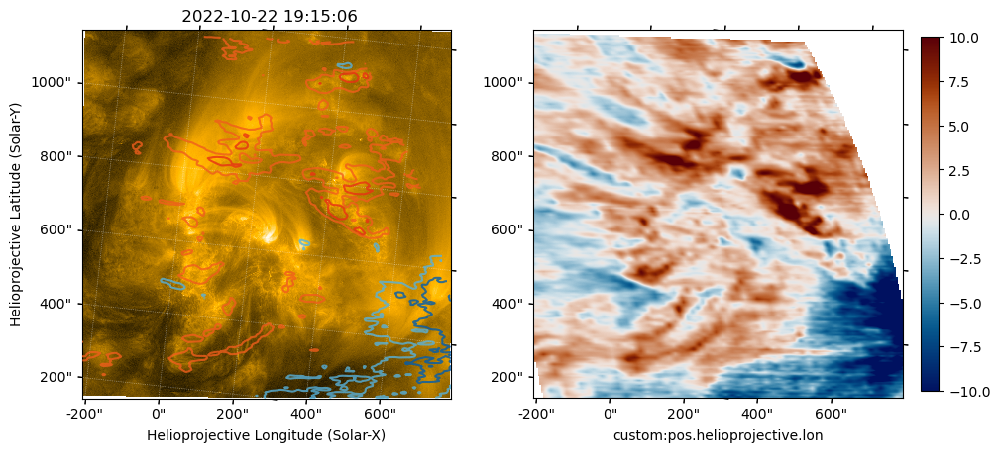

In [146]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted)
im1 = hri_174_map_shifted.plot()
ax1.contour(eis_195_velmap_derot_repro_shifted_hrifov.data,levels=[-10,-5,5,10]*u.km/u.s,colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = ax2.imshow(eis_195_velmap_derot_repro_shifted_hrifov.data,vmin=-10,vmax=10,cmap=cmcm.vik,origin="lower")
plt.colorbar(im2,ax=ax2,shrink=0.8)

ax2.set_ylabel(" ")

In [147]:
eis_195_width_map = eis_195_fitres.get_map(component=0,measurement="width")
eis_195_true_width = np.sqrt( (eis_195_width_map.data * np.sqrt(8*np.log(2)))**2 - (eis_195_fitres.meta["slit_width"][:,np.newaxis])**2)
eis_195_v1oe = eis_195_true_width*u.angstrom/np.sqrt(4*np.log(2))*const.c/(195.119*u.angstrom)
vth2 = 2*const.k_B*(10**6.2)*u.K/const.u/55.85
vnth = np.sqrt(eis_195_v1oe**2 - vth2).to(u.km/u.s)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


/tmp/ipykernel_4065164/4214942759.py:2: RuntimeWarning: invalid value encountered in sqrt
  eis_195_true_width = np.sqrt( (eis_195_width_map.data * np.sqrt(8*np.log(2)))**2 - (eis_195_fitres.meta["slit_width"][:,np.newaxis])**2)
/home/yjzhu/.local/lib/python3.11/site-packages/astropy/units/quantity.py:666: RuntimeWarning: invalid value encountered in sqrt
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


In [148]:
eis_195_vnth_map = sunpy.map.Map(vnth, eis_195_width_map.wcs)
eis_195_vnth_map_shift = eis_195_vnth_map.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)

with propagate_with_solar_surface(rotation_model="rigid"):
    eis_195_vnth_map_shift_derot = eis_195_vnth_map_shift.reproject_to(aia_193_map_crop.wcs)

eis_195_vnth_map_shift_derot_repro = eis_195_vnth_map_shift_derot.reproject_to(fsi_304_crop.wcs)
eis_195_vnth_map_shift_derot_repro_shifted = eis_195_vnth_map_shift_derot_repro.shift_reference_coord(Txshift_aia_fsi,Tyshift_aia_fsi)
eis_195_vnth_map_shift_derot_repro_shifted_hrifov = eis_195_vnth_map_shift_derot_repro_shifted.reproject_to(hri_174_map_shifted.wcs)

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


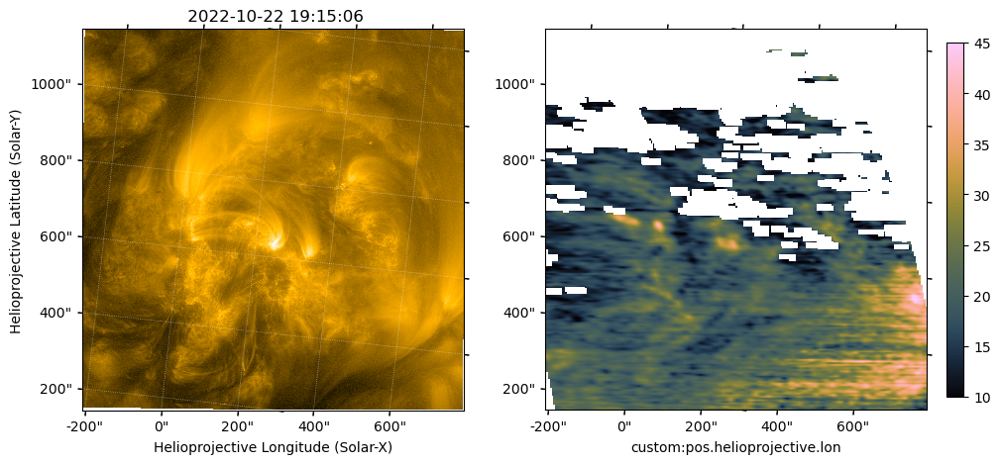

In [149]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted)
im1 = hri_174_map_shifted.plot()
# ax1.contour(eis_195_velmap_derot_repro_shifted_hrifov.data,levels=[-10,-5,5,10]*u.km/u.s,colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = ax2.imshow(eis_195_vnth_map_shift_derot_repro_shifted_hrifov.data,vmin=10,vmax=45,cmap=cmcm.batlowK,origin="lower")
plt.colorbar(im2,ax=ax2,shrink=0.8)

ax2.set_ylabel(" ")

In [150]:
eis_195_vnth_map_shift_derot_repro_shifted_hrifov.plot_settings['norm'] = plt.Normalize(10, 45)
eis_195_vnth_map_shift_derot_repro_shifted_hrifov.plot_settings['cmap'] = cmcm.batlowK

In [151]:
SunBlinker(hri_174_map_shifted, eis_195_vnth_map_shift_derot_repro_shifted_hrifov)

In [152]:
spice_NeVIII_intmap = sunpy.map.Map("../../src/SPICE/20221022/lvl3/NeVIII_770_int_map_205536.fits")

In [153]:
spice_NeVIII_intmap.plot_settings["aspect"] = spice_NeVIII_intmap.scale.axis2/spice_NeVIII_intmap.scale.axis1

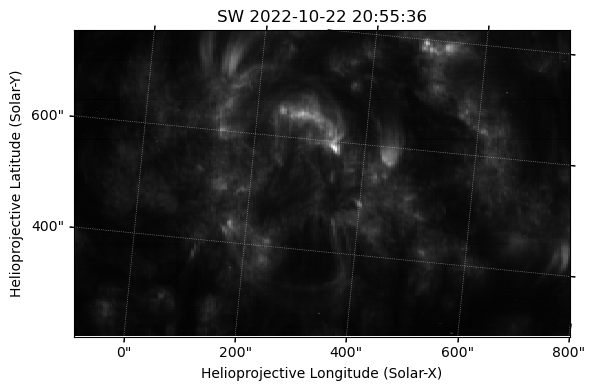

In [154]:
spice_NeVIII_intmap.plot()

In [155]:
with propagate_with_solar_surface(rotation_model="rigid"):
    spice_NeVIII_intmap_derot = spice_NeVIII_intmap.reproject_to(fsi_174_crop.wcs)

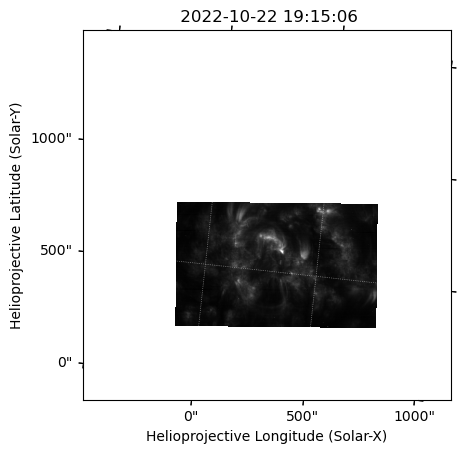

In [156]:
spice_NeVIII_intmap_derot.plot(aspect=fsi_174_crop.scale.axis2/fsi_174_crop.scale.axis1)

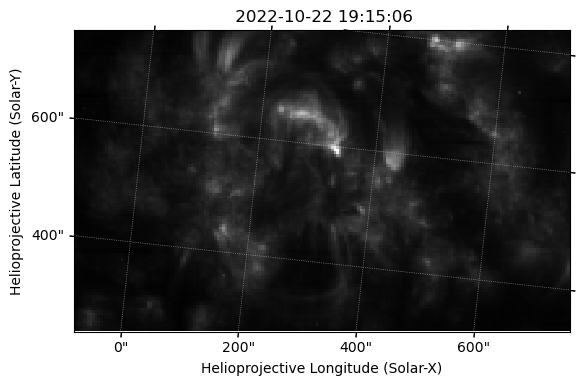

In [157]:
spice_NeVIII_intmap_derot_crop = spice_NeVIII_intmap_derot.submap([100,80]*u.pix,
                                                                  top_right=[290,195]*u.pix)
spice_NeVIII_intmap_derot_crop.plot(aspect=spice_NeVIII_intmap_derot_crop.scale.axis2/spice_NeVIII_intmap_derot_crop.scale.axis1)

In [158]:
spice_NeVIII_Txshift, spice_NeVIII_Tyshift = coalign_shift(fsi_174_crop,spice_NeVIII_intmap_derot_crop)
print(spice_NeVIII_Txshift, spice_NeVIII_Tyshift)

-86.4271 arcsec 31.9426 arcsec


In [159]:
spice_NeVIII_intmap_derot_shift = spice_NeVIII_intmap_derot.shift_reference_coord(spice_NeVIII_Txshift,spice_NeVIII_Tyshift)
spice_NeVIII_intmap_derot_shift_hrifov = spice_NeVIII_intmap_derot_shift.reproject_to(hri_174_map_shifted.wcs)

spice_NeVIII_intmap_derot_shift_hrifov.plot_settings["norm"] = ImageNormalize(vmin=0,vmax=2.2,stretch=AsinhStretch(0.01))
spice_NeVIII_intmap_derot_shift_hrifov.plot_settings["cmap"] = "sdoaia171"
spice_NeVIII_intmap_derot_shift_hrifov.plot_settings["aspect"] = aspect=spice_NeVIII_intmap_derot_shift_hrifov.scale.axis2/ \
                                                                spice_NeVIII_intmap_derot_shift_hrifov.scale.axis1

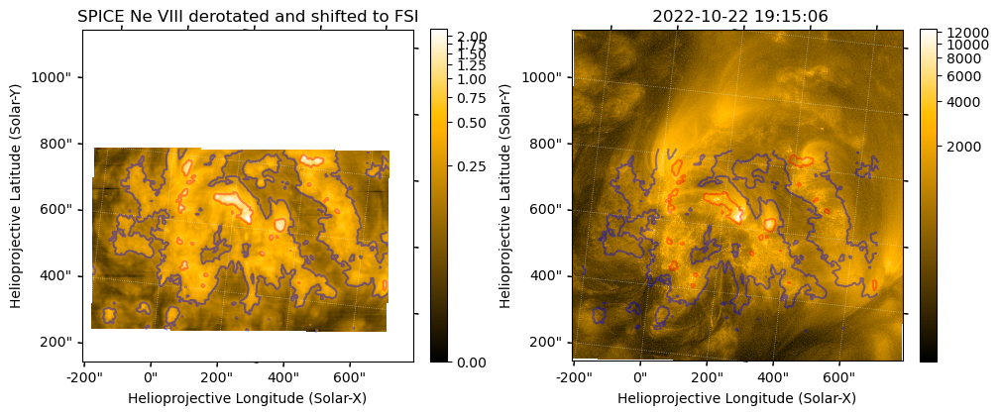

In [160]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=spice_NeVIII_intmap_derot_shift_hrifov)
im1 = spice_NeVIII_intmap_derot_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("SPICE Ne VIII derotated and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

spice_NeVIII_levels = [0.2, 0.8]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    spice_NeVIII_intmap_derot_shift_hrifov.draw_contours(spice_NeVIII_levels,colors=["b","r"], axes=ax_, alpha=0.4)
    ax_.axis(bounds)

In [161]:
SunBlinker(hri_174_map_shifted,spice_NeVIII_intmap_derot_shift_hrifov)

In [162]:
spice_NeVIII_intmap_deconv = sunpy.map.Map("../../src/SPICE/20221022/lvl3/NeVIII_770_deconv_int_map_205536.fits")

In [163]:
with propagate_with_solar_surface(rotation_model="rigid"):
    spice_NeVIII_intmap_deconv_derot = spice_NeVIII_intmap_deconv.reproject_to(hri_174_map_shifted.wcs)
spice_NeVIII_intmap_deconv_derot_shifted = spice_NeVIII_intmap_deconv_derot.shift_reference_coord(spice_NeVIII_Txshift,spice_NeVIII_Tyshift)
spice_NeVIII_intmap_deconv_derot_shifted_hrifov = spice_NeVIII_intmap_deconv_derot_shifted.reproject_to(hri_174_map_shifted.wcs)

In [164]:
spice_NeVIII_intmap_deconv_derot_shifted_hrifov.plot_settings["norm"] = ImageNormalize(vmin=0,vmax=10.,stretch=AsinhStretch(0.05))
spice_NeVIII_intmap_deconv_derot_shifted_hrifov.plot_settings["cmap"] = "sdoaia171"

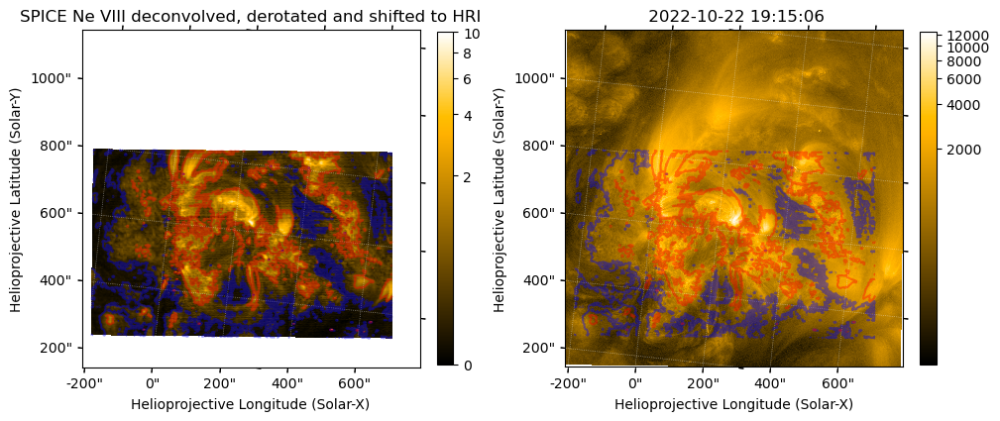

In [165]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=spice_NeVIII_intmap_deconv_derot_shifted_hrifov)
im1 = spice_NeVIII_intmap_deconv_derot_shifted_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("SPICE Ne VIII deconvolved, derotated and shifted to HRI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

spice_NeVIII_levels = [0.2, 0.8]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    spice_NeVIII_intmap_deconv_derot_shifted_hrifov.draw_contours(spice_NeVIII_levels,colors=["b","r"], axes=ax_, alpha=0.4)
    ax_.axis(bounds)

In [166]:
SunBlinker(hri_174_map_shifted,spice_NeVIII_intmap_deconv_derot_shifted_hrifov)

In [167]:
spice_NeVIII_velmap_deconv = sunpy.map.Map("../../src/SPICE/20221022/lvl3/NeVIII_770_deconv_vel_map_205536_columncorr.fits")

with propagate_with_solar_surface(rotation_model="rigid"):
    spice_NeVIII_velmap_deconv_derot = spice_NeVIII_velmap_deconv.reproject_to(hri_174_map_shifted.wcs)
spice_NeVIII_velmap_deconv_derot_shifted = spice_NeVIII_velmap_deconv_derot.shift_reference_coord(spice_NeVIII_Txshift,spice_NeVIII_Tyshift)
spice_NeVIII_velmap_deconv_derot_shifted_hrifov = spice_NeVIII_velmap_deconv_derot_shifted.reproject_to(hri_174_map_shifted.wcs)

In [168]:
spice_NeVIII_velmap_deconv_derot_shifted_hrifov.plot_settings["norm"] = ImageNormalize(vmin=-50,vmax=50)
spice_NeVIII_velmap_deconv_derot_shifted_hrifov.plot_settings["cmap"] = "RdBu_r"

In [169]:
SunBlinker(hri_174_map_shifted,spice_NeVIII_velmap_deconv_derot_shifted_hrifov)